In [101]:
import json
import os

import altair as alt
import scanpy as sc
import pandas as pd
import numpy as np

from pollock.models.model import PollockDataset, PollockModel, predict_from_anndata, load_from_directory

In [4]:
MODULE_FP = './results/10272020_teir2/snRNAseq/ccrcc/pollock_module/'
VAL_RESULTS_FP = './results/10272020_teir2/snRNAseq/ccrcc/pollock.tsv'
DATASET_FP = './data/10232020_harmonized/teir_2/snRNAseq/ccrcc.h5ad'

In [166]:
MODULE_FP = './results/10272020_teir1/scRNAseq/pdac/pollock_module/'
VAL_RESULTS_FP = './results/10272020_teir1/scRNAseq/pdac/pollock.tsv'
DATASET_FP = './data/10232020_harmonized/teir_1/scRNAseq/pdac.h5ad'

In [167]:
adata = sc.read_h5ad(DATASET_FP)
adata

AnnData object with n_obs × n_vars = 177089 × 28756
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'seurat_clusters', 'cell_type', 'sample', 'treatment', 'tissue', 'ident'
    var: 'sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_mean', 'sct.residual_variance', 'sct.variable'
    obsm: 'X_pca', 'X_umap'
    layers: 'logcounts'

In [168]:
predictions = predict_from_anndata(adata.copy(), MODULE_FP)
predictions

/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
2020-10-30 15:50:26,810 normalizing counts for prediction
2020-10-30 15:50:26,811 filtering for genes in training set
2020-10-30 15:50:26,822 0 genes in training set are missing from prediction set
2020-10-30 15:50:27,667 starting batch 1 of 18
/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
2020-10-30 15:50:27,904 normalizing counts for prediction
2020-10-30 15:50:27,905 filtering for genes in training set
2020-10-30 15:50:27,916 0 genes in training set are missing from prediction set
2020-10-30 15:50:56,619 starting batch 2 of

2020-10-30 15:57:25,430 normalizing counts for prediction
2020-10-30 15:57:25,431 filtering for genes in training set
2020-10-30 15:57:25,440 0 genes in training set are missing from prediction set
2020-10-30 15:57:53,673 starting batch 17 of 18
/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
2020-10-30 15:57:53,915 normalizing counts for prediction
2020-10-30 15:57:53,916 filtering for genes in training set
2020-10-30 15:57:53,927 0 genes in training set are missing from prediction set
2020-10-30 15:58:20,921 starting batch 18 of 18
/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full

,predicted_cell_type,cell_type_probability,probability_Acinar,probability_B cell,probability_CD4 T cell,probability_CD8 T cell,probability_Dendritic,probability_Endothelial,probability_Epithelial,probability_Erythrocyte,probability_Fibroblast,probability_Islet,probability_Malignant,probability_Mast,probability_Monocyte,probability_NK,probability_Plasma,probability_Treg,probability_Tuft
HT056P_S1PA_AAACCCAAGTCATCGT-1,Dendritic,0.48,0.00,0.02,0.02,0.00,0.48,0.00,0.02,0.00,0.00,0.01,0.00,0.00,0.43,0.00,0.01,0.01,0.0
HT056P_S1PA_AAACCCACAACCACGC-1,Fibroblast,0.98,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.98,0.00,0.00,0.00,0.00,0.00,0.01,0.01,0.0
HT056P_S1PA_AAACCCATCACCTCAC-1,Monocyte,0.77,0.00,0.00,0.00,0.00,0.20,0.01,0.00,0.00,0.00,0.01,0.00,0.00,0.77,0.00,0.01,0.00,0.0
HT056P_S1PA_AAACGAACACGTAGAG-1,CD8 T cell,0.55,0.00,0.00,0.09,0.55,0.02,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.29,0.01,0.03,0.0
HT056P_S1PA_AAACGAACAGTTAGAA-1,Treg,0.95,0.00,0.00,0.02,0.02,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.95,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HT168P1_S1H4_TTTGTTGAGCAAGCCA-1,Fibroblast,0.61,0.03,0.01,0.01,0.02,0.02,0.16,0.00,0.02,0.61,0.02,0.02,0.03,0.02,0.01,0.01,0.01,0.0
HT168P1_S1H4_TTTGTTGCAATCGCGC-1,Fibroblast,0.64,0.03,0.00,0.01,0.00,0.02,0.05,0.04,0.02,0.64,0.08,0.04,0.00,0.06,0.00,0.00,0.01,0.0
HT168P1_S1H4_TTTGTTGCACACACTA-1,Endothelial,0.92,0.00,0.00,0.00,0.00,0.00,0.92,0.01,0.01,0.00,0.01,0.03,0.01,0.01,0.00,0.00,0.00,0.0
HT168P1_S1H4_TTTGTTGTCATTCGTT-1,NK,0.30,0.00,0.03,0.29,0.15,0.02,0.00,0.00,0.03,0.02,0.00,0.01,0.01,0.01,0.30,0.03,0.10,0.0


In [169]:
adata.obs = pd.merge(adata.obs, predictions, left_index=True, right_index=True)
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,nCount_SCT,nFeature_SCT,SCT_snn_res.0.5,seurat_clusters,cell_type,sample,...,probability_Erythrocyte,probability_Fibroblast,probability_Islet,probability_Malignant,probability_Mast,probability_Monocyte,probability_NK,probability_Plasma,probability_Treg,probability_Tuft
HT056P_S1PA_AAACCCAAGTCATCGT-1,TWCE-HT056P-S1PAA1-lib1,12420.0,2958,0.096377,5875.0,1964,6,6,Monocyte,HT056P,...,0.00,0.00,0.01,0.00,0.00,0.43,0.00,0.01,0.01,0.0
HT056P_S1PA_AAACCCACAACCACGC-1,TWCE-HT056P-S1PAA1-lib1,11072.0,3471,0.068009,6403.0,2972,7,7,Fibroblast,HT056P,...,0.00,0.98,0.00,0.00,0.00,0.00,0.00,0.01,0.01,0.0
HT056P_S1PA_AAACCCATCACCTCAC-1,TWCE-HT056P-S1PAA1-lib1,15507.0,3925,0.045850,5567.0,1823,6,6,Monocyte,HT056P,...,0.00,0.00,0.01,0.00,0.00,0.77,0.00,0.01,0.00,0.0
HT056P_S1PA_AAACGAACACGTAGAG-1,TWCE-HT056P-S1PAA1-lib1,4221.0,1715,0.082445,4648.0,1715,10,10,CD8 T cell,HT056P,...,0.00,0.00,0.00,0.00,0.01,0.00,0.29,0.01,0.03,0.0
HT056P_S1PA_AAACGAACAGTTAGAA-1,TWCE-HT056P-S1PAA1-lib1,5649.0,2068,0.088865,5425.0,2068,0,0,Treg,HT056P,...,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.95,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HT168P1_S1H4_TTTGTTGAGCAAGCCA-1,TWCE-HT168P1-BC4-HT168P1-BC4_1,14649.0,3160,0.068878,5570.0,1444,8,8,Fibroblast,HT168P1,...,0.02,0.61,0.02,0.02,0.03,0.02,0.01,0.01,0.01,0.0
HT168P1_S1H4_TTTGTTGCAATCGCGC-1,TWCE-HT168P1-BC4-HT168P1-BC4_1,1546.0,1043,0.001294,3634.0,1236,2,2,Fibroblast,HT168P1,...,0.02,0.64,0.08,0.04,0.00,0.06,0.00,0.00,0.01,0.0
HT168P1_S1H4_TTTGTTGCACACACTA-1,TWCE-HT168P1-BC4-HT168P1-BC4_1,6734.0,2791,0.063707,5924.0,2791,5,5,Endothelial,HT168P1,...,0.01,0.00,0.01,0.03,0.01,0.01,0.00,0.00,0.00,0.0
HT168P1_S1H4_TTTGTTGTCATTCGTT-1,TWCE-HT168P1-BC4-HT168P1-BC4_1,7440.0,2132,0.001882,5836.0,2129,10,10,CD8 T cell,HT168P1,...,0.03,0.02,0.00,0.01,0.01,0.01,0.30,0.03,0.10,0.0


#### examine module

In [170]:
summary = json.load(open(os.path.join(MODULE_FP, 'summary.json')))
summary.keys()

dict_keys(['history', 'model_parameters', 'training', 'validation'])

In [171]:
summary['model_parameters']

{'alpha': 0.0001,
 'learning_rate': 0.0001,
 'latent_dim': 25,
 'cell_types': ['Acinar',
  'B cell',
  'CD4 T cell',
  'CD8 T cell',
  'Dendritic',
  'Endothelial',
  'Epithelial',
  'Erythrocyte',
  'Fibroblast',
  'Islet',
  'Malignant',
  'Mast',
  'Monocyte',
  'NK',
  'Plasma',
  'Treg',
  'Tuft']}

In [172]:
confusion_matrix = pd.DataFrame(data=np.asarray(summary['validation']['confusion_matrix']) * 1.,
                                columns=summary['model_parameters']['cell_types'],
                                index=summary['model_parameters']['cell_types'])
confusion_matrix

,Acinar,B cell,CD4 T cell,CD8 T cell,Dendritic,Endothelial,Epithelial,Erythrocyte,Fibroblast,Islet,Malignant,Mast,Monocyte,NK,Plasma,Treg,Tuft
Acinar,0.90,0.00,0.01,0.02,0.00,0.01,0.03,0.01,0.00,0.00,0.03,0.00,0.00,0.00,0.00,0.00,0.00
B cell,0.00,0.96,0.01,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.00,0.00,0.01,0.01,0.00,0.00
CD4 T cell,0.00,0.01,0.74,0.14,0.00,0.00,0.00,0.02,0.00,0.00,0.00,0.00,0.00,0.02,0.00,0.07,0.00
CD8 T cell,0.00,0.01,0.16,0.69,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.00,0.00,0.10,0.00,0.02,0.00
Dendritic,0.00,0.00,0.00,0.02,0.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.23,0.12,0.00,0.00,0.00
Endothelial,0.01,0.00,0.00,0.00,0.00,0.95,0.01,0.00,0.03,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Epithelial,0.01,0.00,0.00,0.00,0.00,0.00,0.88,0.00,0.00,0.00,0.09,0.00,0.01,0.00,0.00,0.00,0.00
Erythrocyte,0.02,0.10,0.17,0.11,0.00,0.10,0.00,0.42,0.00,0.01,0.00,0.00,0.00,0.02,0.04,0.01,0.00
Fibroblast,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.95,0.03,0.00,0.00,0.00,0.00,0.00,0.00,0.00
Islet,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.01,0.95,0.01,0.00,0.00,0.00,0.01,0.01,0.00


In [173]:
confusion_matrix['groundtruth'] = confusion_matrix.index.to_list()
df = confusion_matrix.melt(id_vars=['groundtruth'])
df.columns = ['groundtruth', 'predicted', '% of cells']
df

,groundtruth,predicted,% of cells
0,Acinar,Acinar,0.90
1,B cell,Acinar,0.00
2,CD4 T cell,Acinar,0.00
3,CD8 T cell,Acinar,0.00
4,Dendritic,Acinar,0.00
...,...,...,...
284,Monocyte,Tuft,0.00
285,NK,Tuft,0.00
286,Plasma,Tuft,0.00
287,Treg,Tuft,0.00


In [174]:
chart = alt.Chart(df).mark_rect().encode(
    x=alt.X('predicted'),
    y=alt.Y('groundtruth'),
    color=alt.Color('% of cells', scale=alt.Scale(scheme='viridis'))
)
chart

alt.Chart(...)

In [175]:
summary['history'].keys()

dict_keys(['train_loss', 'validation_loss', 'train_accuracy', 'validation_accuracy', 'cell_type_train_loss', 'cell_type_val_loss', 'cell_type_train_f1', 'cell_type_val_f1'])

In [176]:
loss, label, epoch, acc = [], [], [], []
for k_loss, k_acc in [('train_loss', 'train_accuracy'), ('validation_loss', 'validation_accuracy')]:
    loss += summary['history'][k_loss]
    acc += summary['history'][k_acc]
#     acc += ['loss'] * len(summary['history'][k_loss])
    label += ['train' if 'train' in k_loss else 'validation'] * len(summary['history'][k_loss])
    epoch += [x+1 for x in list(range(len(summary['history'][k_loss])))]
    
#     loss += summary['history'][k_acc]
# #     acc += summary['history'][k_acc]
#     acc += ['accuracy'] * len(summary['history'][k_acc])
#     label += ['train' if 'train' in k_acc else 'validation'] * len(summary['history'][k_acc])
#     epoch += list(range(len(summary['history'][k_acc])))

df = pd.DataFrame.from_dict({'dataset': label, 'loss': loss, 'accuracy': acc, 'epoch': epoch})
df


,dataset,loss,accuracy,epoch
0,train,30.163652,1.000000,1
1,train,29.079548,1.000000,2
2,train,28.551512,1.000000,3
3,train,28.354654,1.000000,4
4,train,28.153341,1.000000,5
5,train,27.961166,1.000000,6
6,train,27.816181,1.000000,7
7,train,27.699270,1.000000,8
8,train,27.596889,1.000000,9
9,train,27.500753,1.000000,10


In [177]:
chart = alt.Chart(df).encode(x=alt.X('epoch:O', scale=alt.Scale(zero=False)))

loss = chart.mark_line().encode(
    y=alt.Y('loss', scale=alt.Scale(zero=False)),
    color='dataset',
#     strokeDash='type'
)
acc = chart.mark_line(strokeDash=[2,2]).encode(
    y=alt.Y('accuracy', scale=alt.Scale(zero=False)),
    color='dataset',
)

alt.layer(loss, acc).resolve_scale(
    y = 'independent'
)

alt.LayerChart(...)

In [178]:
loss, label, epoch = [], [], []
for k in ['cell_type_val_loss']:
    for cell_type, vals in summary['history'][k].items():
        loss += vals
        label += [cell_type] * len(vals)
        epoch += list(range(len(vals)))
    
df = pd.DataFrame.from_dict({
    'cell_type': label,
    'loss': loss,
    'epoch': epoch
})
# df

chart = alt.Chart(df).mark_line().encode(
    x='epoch',
    y=alt.Y('loss', scale=alt.Scale(zero=False)),
    color='cell_type'
)
chart
# loss, label, epoch = [], [], []
# for k in ['cell_type_val_f1']:
#     for cell_type, vals in summary['history'][k].items():
#         loss += vals
#         label += [cell_type] * len(vals)
#         epoch += list(range(len(vals)))
    
# df = pd.DataFrame.from_dict({
#     'cell_type': label,
#     'accuracy': loss,
#     'epoch': epoch
# })

alt.Chart(...)

In [179]:
# loss, label, epoch = [], [], []
# for k in ['cell_type_val_loss']:
#     for cell_type, vals in summary['history'][k].items():
#         loss += vals
#         label += [cell_type] * len(vals)
#         epoch += list(range(len(vals)))
    
# df = pd.DataFrame.from_dict({
#     'cell_type': label,
#     'loss': loss,
#     'epoch': epoch
# })
# # df


loss, label, epoch = [], [], []
for k in ['cell_type_val_f1']:
    for cell_type, vals in summary['history'][k].items():
        loss += vals
        label += [cell_type] * len(vals)
        epoch += [x+1 for x in list(range(len(vals)))]
    
df = pd.DataFrame.from_dict({
    'cell_type': label,
    'accuracy': loss,
    'epoch': epoch
})

chart = alt.Chart(df).mark_line().encode(
    x=alt.X('epoch:O', scale=alt.Scale(zero=False)),
    y=alt.Y('accuracy', scale=alt.Scale(zero=False)),
    color='cell_type'
)
chart

alt.Chart(...)

#### examine embeddings

In [180]:
adata

AnnData object with n_obs × n_vars = 177089 × 28756
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'seurat_clusters', 'cell_type', 'sample', 'treatment', 'tissue', 'ident', 'predicted_cell_type', 'cell_type_probability', 'probability_Acinar', 'probability_B cell', 'probability_CD4 T cell', 'probability_CD8 T cell', 'probability_Dendritic', 'probability_Endothelial', 'probability_Epithelial', 'probability_Erythrocyte', 'probability_Fibroblast', 'probability_Islet', 'probability_Malignant', 'probability_Mast', 'probability_Monocyte', 'probability_NK', 'probability_Plasma', 'probability_Treg', 'probability_Tuft'
    var: 'sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_mean', 'sct.residual_variance', 'sct.variable'
    obsm: 'X_pca', 'X_umap'
    layers: 'logcounts'

In [181]:
def sample_index(df, key, n=1000):
    groups = sorted(set(df[key]))
    idxs = []
    for g in groups:
        filtered = df[df[key]==g]
        if filtered.shape[0] < n:
            idxs += list(filtered.index)
        else:
            idxs += list(np.random.choice(filtered.index, size=n, replace=False))
    return np.asarray(idxs)
plt_idxs = sample_index(adata.obs, 'cell_type', n=500)

In [209]:
sc.settings.figdir = '/home/estorrs/pollock/benchmarking/sandbox'
sc.set_figure_params(dpi_save=300)

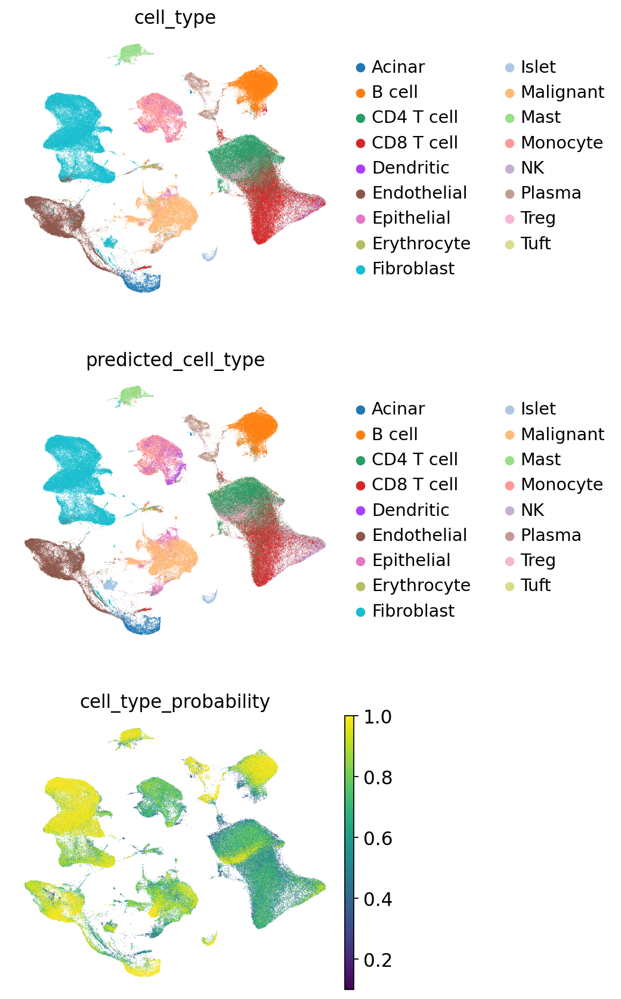

In [210]:
sc.pl.umap(adata, color=['cell_type', 'predicted_cell_type', 'cell_type_probability'], frameon=False,
          ncols=1, save='_pdac_cell_umaps.png')

In [187]:
data = adata.obs.copy()
data['UMAP1'] = adata.obsm['X_umap'][:, 0].flatten()
data['UMAP2'] = adata.obsm['X_umap'][:, 1].flatten()
data.index = adata.obs.index
data = data.loc[plt_idxs]
# c = [c.replace('.', '_') for c in data.columns]
# c[0] = 'sample_id'
# data.columns = c
data

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,nCount_SCT,nFeature_SCT,SCT_snn_res.0.5,seurat_clusters,cell_type,sample,...,probability_Islet,probability_Malignant,probability_Mast,probability_Monocyte,probability_NK,probability_Plasma,probability_Treg,probability_Tuft,UMAP1,UMAP2
HT168P1_S1H3_CATTGAGGTCTAGGCC-1,TWCE-HT168P1-BC3-HT168P1-BC3_1,3099.0,288,0.043240,4295.0,301,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,-2.509645,-14.634559
HT168P1_S1H3_TACCCGTTCTAGTACG-1,TWCE-HT168P1-BC3-HT168P1-BC3_1,2918.0,1140,0.052433,4276.0,1142,13,13,Acinar,HT168P1,...,0.01,0.03,0.03,0.04,0.00,0.00,0.00,0.00,-4.146798,-13.053256
HT168P1_M1_AACTTCTTCCTGGGTG-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1774.0,276,0.003382,3656.0,435,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-2.835975,-14.966225
HT168P1_M1_AAGGAATCATGTTCAG-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1117.0,293,0.034020,3357.0,587,13,13,Acinar,HT168P1,...,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-3.409268,-14.398538
HT168P1_M1_GAACGTTGTAGTCCTA-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1641.0,300,0.059720,3657.0,484,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-2.822848,-13.947059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HT056P_S1R1_TACAACGCAAGTGACG-1,TWCE-HT056P-S1R1A1-lib1,18622.0,4141,0.089571,5615.0,1698,11,11,Tuft,HT056P,...,0.03,0.00,0.10,0.01,0.02,0.02,0.02,0.64,-4.693528,12.649200
HT056P_S1R1_TCAGTCCGTGGTCTGC-1,TWCE-HT056P-S1R1A1-lib1,8757.0,2751,0.071600,6109.0,2705,11,11,Tuft,HT056P,...,0.00,0.00,0.06,0.00,0.00,0.00,0.00,0.94,-2.175141,13.306320
HT056P_S1R1_TTCTTCCCAACTCGAT-1,TWCE-HT056P-S1R1A1-lib1,10545.0,2740,0.098625,6225.0,2420,11,11,Tuft,HT056P,...,0.00,0.00,0.17,0.00,0.00,0.00,0.00,0.83,-4.138546,14.084716
HT056P_S1R1_TTGCATTGTGTGTTTG-1,TWCE-HT056P-S1R1A1-lib1,1806.0,778,0.026578,4057.0,843,11,11,Tuft,HT056P,...,0.01,0.00,0.28,0.00,0.00,0.00,0.00,0.68,-3.255930,13.262590


In [188]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [189]:
chart = alt.Chart(data).encode(
    x=alt.X('UMAP1', scale=alt.Scale(zero=False), axis=alt.Axis(grid=False)),
    y=alt.Y('UMAP2', scale=alt.Scale(zero=False), axis=alt.Axis(grid=False))
)

c1 = chart.mark_circle().encode(
    color=alt.Color('cell_type', scale=alt.Scale(scheme='category20')),
)

c2 = chart.mark_circle().encode(
    color=alt.Color('predicted_cell_type', scale=alt.Scale(scheme='category20'))
)

c3 = chart.mark_circle().encode(
    color=alt.Color('sample:N', scale=alt.Scale(scheme='category20'))
)

c1 | c2

alt.HConcatChart(...)

In [190]:
c3

alt.Chart(...)

In [191]:
loaded_pds, loaded_pm = load_from_directory(adata[plt_idxs].copy(), MODULE_FP)

/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
2020-10-30 16:09:44,966 normalizing counts for prediction
2020-10-30 16:09:44,967 filtering for genes in training set
2020-10-30 16:09:44,978 0 genes in training set are missing from prediction set


In [192]:
labels, probs, cell_type_probs = loaded_pm.predict_pollock_dataset(loaded_pds, labels=True, )

df = pd.DataFrame.from_dict({
    'predicted_cell_type': labels,
    'cell_type_probability': probs,
})
df.index = adata[plt_idxs].obs.index
df = pd.concat((df, pd.DataFrame(data=cell_type_probs, index=adata[plt_idxs].obs.index,
                            columns=[f'probability_{c}' for c in loaded_pds.cell_types])), axis=1)
df

/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


,predicted_cell_type,cell_type_probability,probability_Acinar,probability_B cell,probability_CD4 T cell,probability_CD8 T cell,probability_Dendritic,probability_Endothelial,probability_Epithelial,probability_Erythrocyte,probability_Fibroblast,probability_Islet,probability_Malignant,probability_Mast,probability_Monocyte,probability_NK,probability_Plasma,probability_Treg,probability_Tuft
HT168P1_S1H3_CATTGAGGTCTAGGCC-1,Acinar,0.95,0.95,0.02,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.03,0.00,0.00
HT168P1_S1H3_TACCCGTTCTAGTACG-1,Endothelial,0.44,0.29,0.00,0.0,0.00,0.00,0.44,0.05,0.02,0.09,0.03,0.03,0.01,0.04,0.00,0.00,0.00,0.00
HT168P1_M1_AACTTCTTCCTGGGTG-1,Acinar,0.99,0.99,0.00,0.0,0.00,0.00,0.00,0.00,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
HT168P1_M1_AAGGAATCATGTTCAG-1,Acinar,0.90,0.90,0.00,0.0,0.00,0.00,0.00,0.00,0.03,0.00,0.03,0.00,0.00,0.00,0.00,0.04,0.00,0.00
HT168P1_M1_GAACGTTGTAGTCCTA-1,Acinar,0.99,0.99,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HT056P_S1R1_TACAACGCAAGTGACG-1,Tuft,0.64,0.00,0.00,0.0,0.02,0.02,0.08,0.02,0.00,0.02,0.03,0.00,0.10,0.01,0.02,0.03,0.01,0.64
HT056P_S1R1_TCAGTCCGTGGTCTGC-1,Tuft,0.94,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.06,0.00,0.00,0.00,0.00,0.94
HT056P_S1R1_TTCTTCCCAACTCGAT-1,Tuft,0.83,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.17,0.00,0.00,0.00,0.00,0.83
HT056P_S1R1_TTGCATTGTGTGTTTG-1,Tuft,0.66,0.00,0.00,0.0,0.00,0.01,0.01,0.00,0.00,0.00,0.01,0.00,0.31,0.00,0.00,0.00,0.00,0.66


In [193]:
cell_embeddings = loaded_pm.get_cell_embeddings(loaded_pds.prediction_ds)
cell_embeddings.shape, cell_embeddings

((8151, 25), array([[ 1.3366662e-02, -1.0588220e+00, -8.0617234e-02, ...,
         -8.5506670e-02,  3.2708541e-02,  4.7242585e-01],
        [-6.1508274e-01, -2.1883981e+00, -4.2926860e-01, ...,
          8.3975695e-02,  4.8904979e-01,  6.4768118e-01],
        [-5.0121403e-01, -8.5616803e-01, -2.5320220e-01, ...,
          2.9173985e-01,  4.4403026e-01,  6.1778432e-01],
        ...,
        [-2.3980577e+00, -2.8156021e+00, -5.8831453e-01, ...,
         -1.1226898e+00, -2.3531806e-01,  2.7353597e+00],
        [-1.9205370e+00, -1.9109038e+00, -4.4026846e-01, ...,
         -3.9251640e-01,  1.2895446e-03,  9.6779150e-01],
        [-2.5043969e+00, -2.7511978e+00, -4.4108030e-01, ...,
         -1.1801273e+00, -4.2281783e-01,  1.9230235e+00]], dtype=float32))

In [194]:
tiny = adata[plt_idxs].copy()
tiny.obsm['cell_embeddings'] = cell_embeddings
tiny

/home/estorrs/miniconda3/envs/pollock_dev/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


AnnData object with n_obs × n_vars = 8151 × 28756
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.5', 'seurat_clusters', 'cell_type', 'sample', 'treatment', 'tissue', 'ident', 'predicted_cell_type', 'cell_type_probability', 'probability_Acinar', 'probability_B cell', 'probability_CD4 T cell', 'probability_CD8 T cell', 'probability_Dendritic', 'probability_Endothelial', 'probability_Epithelial', 'probability_Erythrocyte', 'probability_Fibroblast', 'probability_Islet', 'probability_Malignant', 'probability_Mast', 'probability_Monocyte', 'probability_NK', 'probability_Plasma', 'probability_Treg', 'probability_Tuft'
    var: 'sct.detection_rate', 'sct.gmean', 'sct.variance', 'sct.residual_mean', 'sct.residual_variance', 'sct.variable'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap', 'cell_embeddings'
    layers: 'logcounts'

In [195]:
sc.pp.neighbors(tiny, use_rep='cell_embeddings')
sc.tl.umap(tiny)

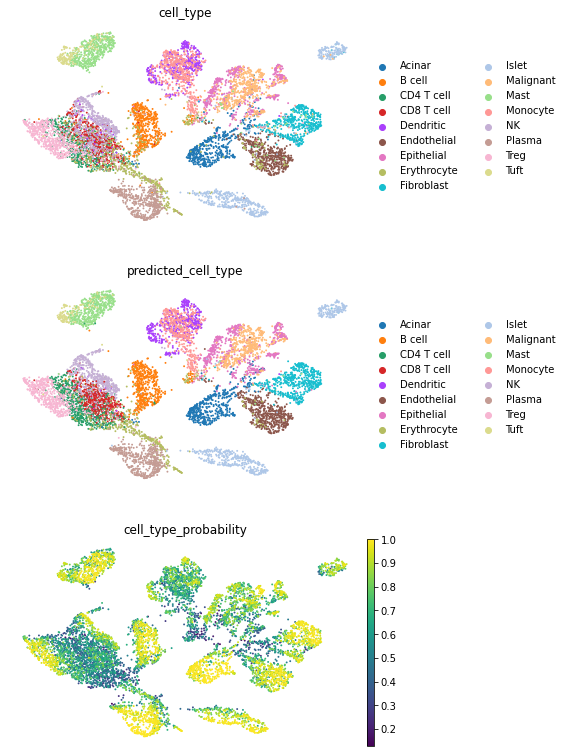

In [196]:
sc.pl.umap(tiny, color=['cell_type', 'predicted_cell_type', 'cell_type_probability'],
          frameon=False, ncols=1)

In [197]:
data = tiny.obs.copy()
data['UMAP1'] = tiny.obsm['X_umap'][:, 0].flatten()
data['UMAP2'] = tiny.obsm['X_umap'][:, 1].flatten()
data.index = tiny.obs.index
# data.columns = [c.replace('.', '_') for c in data.columns]
# c = [c.replace('.', '_') for c in data.columns]
# c[0] = 'sample_id'
# data.columns = c
data

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,nCount_SCT,nFeature_SCT,SCT_snn_res.0.5,seurat_clusters,cell_type,sample,...,probability_Islet,probability_Malignant,probability_Mast,probability_Monocyte,probability_NK,probability_Plasma,probability_Treg,probability_Tuft,UMAP1,UMAP2
HT168P1_S1H3_CATTGAGGTCTAGGCC-1,TWCE-HT168P1-BC3-HT168P1-BC3_1,3099.0,288,0.043240,4295.0,301,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.00,6.219521,1.594143
HT168P1_S1H3_TACCCGTTCTAGTACG-1,TWCE-HT168P1-BC3-HT168P1-BC3_1,2918.0,1140,0.052433,4276.0,1142,13,13,Acinar,HT168P1,...,0.01,0.03,0.03,0.04,0.00,0.00,0.00,0.00,8.858473,4.793925
HT168P1_M1_AACTTCTTCCTGGGTG-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1774.0,276,0.003382,3656.0,435,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,6.276086,1.675465
HT168P1_M1_AAGGAATCATGTTCAG-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1117.0,293,0.034020,3357.0,587,13,13,Acinar,HT168P1,...,0.01,0.00,0.00,0.00,0.00,0.00,0.00,0.00,5.315650,3.114803
HT168P1_M1_GAACGTTGTAGTCCTA-1,TWCE-HT168P1-BC1-HT168P1-BC1_1,1641.0,300,0.059720,3657.0,484,13,13,Acinar,HT168P1,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,5.809958,2.765993
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HT056P_S1R1_TACAACGCAAGTGACG-1,TWCE-HT056P-S1R1A1-lib1,18622.0,4141,0.089571,5615.0,1698,11,11,Tuft,HT056P,...,0.03,0.00,0.10,0.01,0.02,0.02,0.02,0.64,-1.766631,14.030112
HT056P_S1R1_TCAGTCCGTGGTCTGC-1,TWCE-HT056P-S1R1A1-lib1,8757.0,2751,0.071600,6109.0,2705,11,11,Tuft,HT056P,...,0.00,0.00,0.06,0.00,0.00,0.00,0.00,0.94,-4.346309,13.224224
HT056P_S1R1_TTCTTCCCAACTCGAT-1,TWCE-HT056P-S1R1A1-lib1,10545.0,2740,0.098625,6225.0,2420,11,11,Tuft,HT056P,...,0.00,0.00,0.17,0.00,0.00,0.00,0.00,0.83,-4.067570,12.549031
HT056P_S1R1_TTGCATTGTGTGTTTG-1,TWCE-HT056P-S1R1A1-lib1,1806.0,778,0.026578,4057.0,843,11,11,Tuft,HT056P,...,0.01,0.00,0.28,0.00,0.00,0.00,0.00,0.68,-1.350259,15.087957


In [198]:
chart = alt.Chart(data).encode(
    x=alt.X('UMAP1', scale=alt.Scale(zero=False), axis=alt.Axis(grid=False)),
    y=alt.Y('UMAP2', scale=alt.Scale(zero=False), axis=alt.Axis(grid=False))
)

c1 = chart.mark_circle().encode(
    color=alt.Color('cell_type', scale=alt.Scale(scheme='category20')),
)

c2 = chart.mark_circle().encode(
    color=alt.Color('predicted_cell_type', scale=alt.Scale(scheme='category20'))
)

c3 = chart.mark_circle().encode(
    color=alt.Color('sample:N', scale=alt.Scale(scheme='category20'))
)

c1 | c2

alt.HConcatChart(...)

In [199]:
c3

alt.Chart(...)